# Image Augmentation with Albumentations - Melanoma Dataset

Sources:
- https://www.kaggle.com/stopwhispering/augmentation-w-albumentations-melanoma-dataset/edit

In [ ]:
# running interactively in kaggle or as background job in kaggle
import os
if (get_ipython().config.IPKernelApp.connection_file.startswith('/root/.local/share')
    or 'SHLVL' in os.environ):
    BASE_PATH = '/kaggle/input/'
    
else:
    BASE_PATH = '../data/'

In [1]:
from pathlib import Path
from typing import Union
import math

import albumentations
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2

# Load Data 

In [4]:
image_names = ('ISIC_0015719', 'ISIC_0074311', 'ISIC_0083035', 'ISIC_0078712')  # , 'ISIC_0084395')
image_paths = [Path(f'{BASE_PATH}siim-isic-melanoma-classification/jpeg/train/{image_name}.jpg') for image_name in image_names]
images = [plt.imread(path) for path in image_paths]  # list of np.ndarray (height, width, 3), uint8, values 0..255
 
for image in images:
    print(image.shape, image.dtype, image.min(), image.max())

(4000, 6000, 3) uint8 0 255
(4000, 6000, 3) uint8 0 255
(4000, 6000, 3) uint8 0 255
(2448, 3264, 3) uint8 2 254


# Utility Functions

In [5]:
def plot_images(images: list[Union[np.array, list[np.array]]], 
                suptitle='', 
                titles=[], 
                display_shape=False,
                cmap='gray'):  # (n, width, length)
    
    assert len(set(len(i) for i in images)) == 1
    assert len(titles) == 0 or len(titles) == len(images)
    n_cols = len(images[0])
    n_rows = len(images)
    
    fig, axes = plt.subplots(nrows=n_rows, 
                             ncols=n_cols,
                             figsize=(n_cols*6, n_rows*4))
    
    if len(axes.shape) == 1:
        axes = axes.reshape(1, n_cols)  # for convenience: (n_cols,) -> (1, n_cols)
    
    for row_idx, sub_images in enumerate(images):  # sub_images: list of images or np.ndarray of size (n,h,w,c)
        
        if titles:
            axes[row_idx, 0].set_title(titles[row_idx], fontsize=26)
                 
        for col_idx, image in enumerate(sub_images):  # image: np.ndarray
            
            ax = axes[row_idx, col_idx]
            ax.imshow(X=image,
                      cmap=cmap)  # plt.cm.bone
            ax.set_xticks([])
            ax.set_yticks([])
            
            if display_shape:
                ax.set_title(image.shape if not ax.get_title() else f'{ax.get_title()} {image.shape}')
        
    if suptitle:
        plt.suptitle(suptitle, fontsize=30)
    
    # plt.tight_layout()
    plt.show()

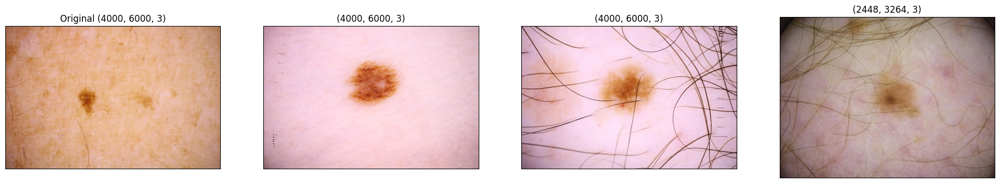

In [6]:
# original images only
plot_images([images], titles=['Original'], display_shape=True)

# Augmentation

Input of albumentation transforms must be a np.array for a single image.
- No batch processing.
- No tensors.

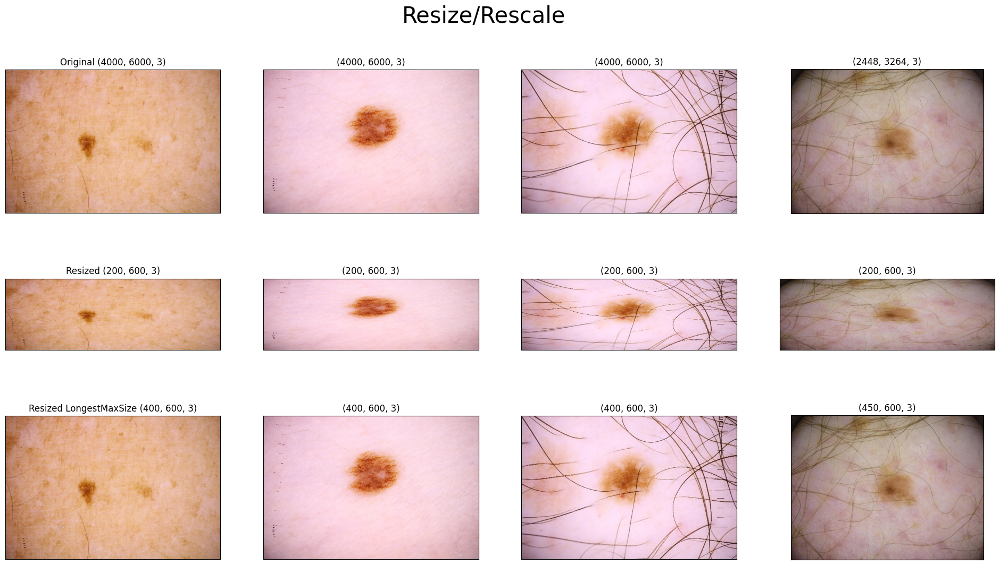

In [7]:
height = 200
width = 600

# resize  - Resize exactly to the given height and width
transform = albumentations.Resize(height=height, 
                                  width=width, 
                                  p=1,  # default: 1 
                                  interpolation=cv2.INTER_LINEAR  # default: cv2.INTER_LINEAR
                                 )
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

# resize w/ LongestMaxSize - Rescale so that maximum side is equal to max_size, keeping the aspect ratio 
transform2 = albumentations.augmentations.geometric.resize.LongestMaxSize(max_size=600,
                                                                          p=1)
transformed2 = [transform2(image=image) for image in images]
transformed_images2 = [t['image'] for t in transformed2]

plot_images([images, transformed_images, transformed_images2], 
            suptitle='Resize/Rescale', 
            titles=['Original', 'Resized', 'Resized LongestMaxSize'],
            display_shape=True)

# for performance, we will use the rescaled images below
# in a productive project, one will resize to the the end of the pipeline!
images = transformed_images2

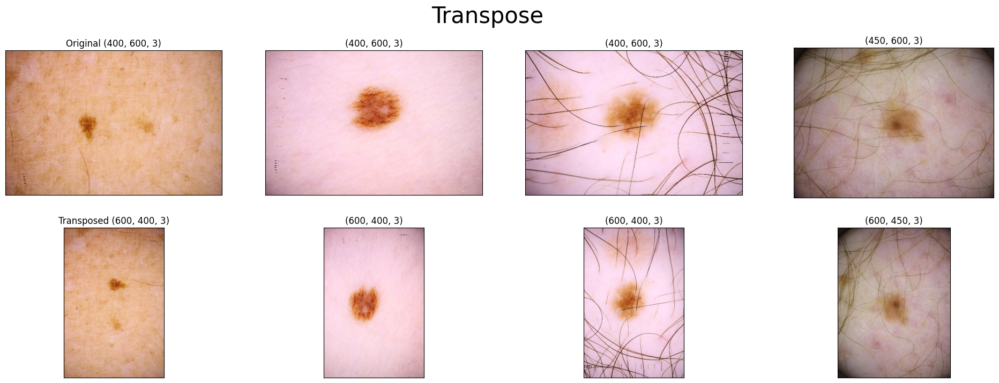

In [8]:
# transpose - swap rows and columns
transform = albumentations.Transpose(p=1)

# albumentations transforms <<one>> image (can't provide whole batch)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]


plot_images([images, transformed_images], 
            suptitle='Transpose', 
            titles=['Original', 'Transposed'],
            display_shape=True)

In [9]:
# transpose - swap rows and columns

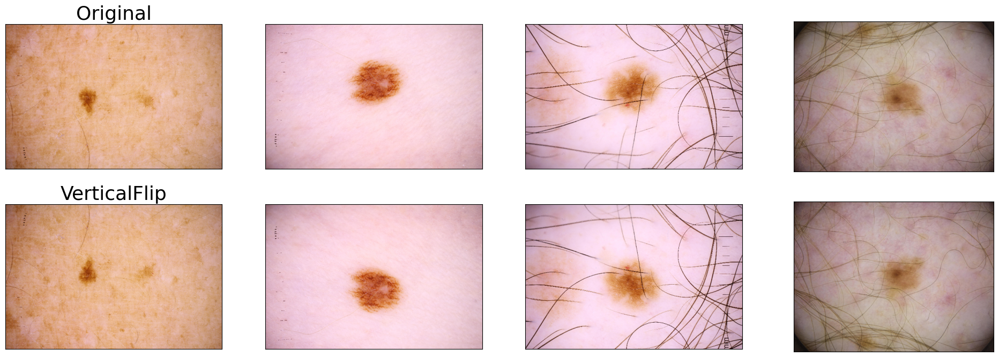

In [10]:
# VerticalFlip - Flip vertically around the x-axis.
transform = albumentations.VerticalFlip(p=1)

# albumentations transforms <<one>> image (can't provide whole batch)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'VerticalFlip'])

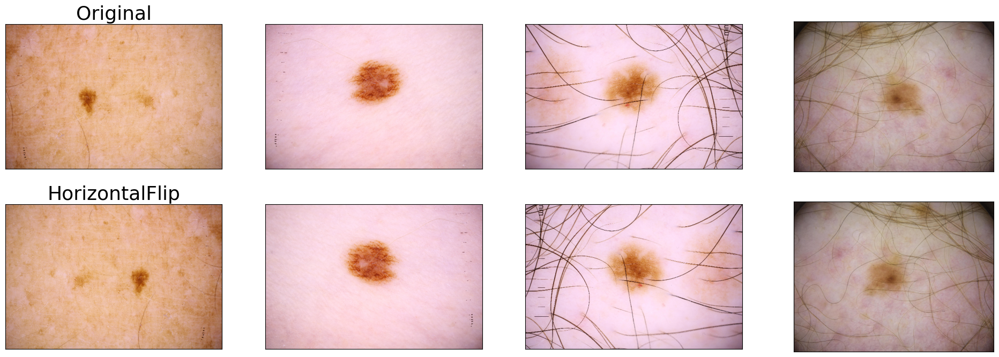

In [11]:
# HorizontalFlip - Flip horizontally around the y-axis.
transform = albumentations.HorizontalFlip(p=1)

# albumentations transforms <<one>> image (can't provide whole batch)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'HorizontalFlip'])

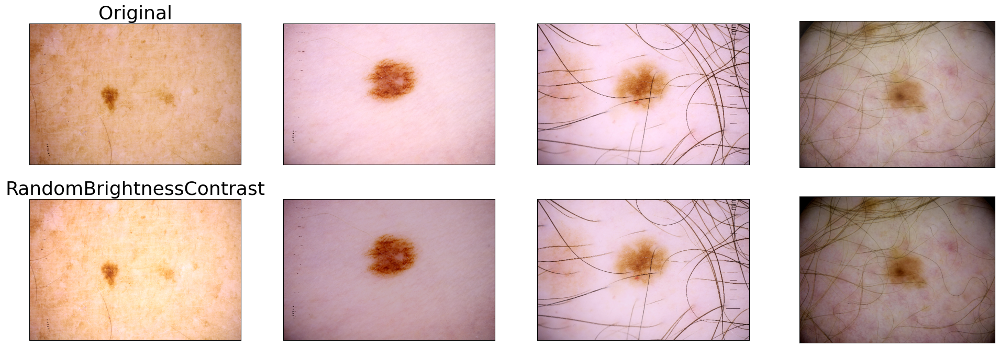

In [12]:
# RandomBrightnessContrast  - Randomly change brightness and contrast

# The parameters are random for <<each image>> that is processed!
transform = albumentations.RandomBrightnessContrast (brightness_limit=0.2, 
                                                     contrast_limit=0.2, 
                                                     p=1)

# albumentations transforms <<one>> image (can't provide whole batch)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'RandomBrightnessContrast'])

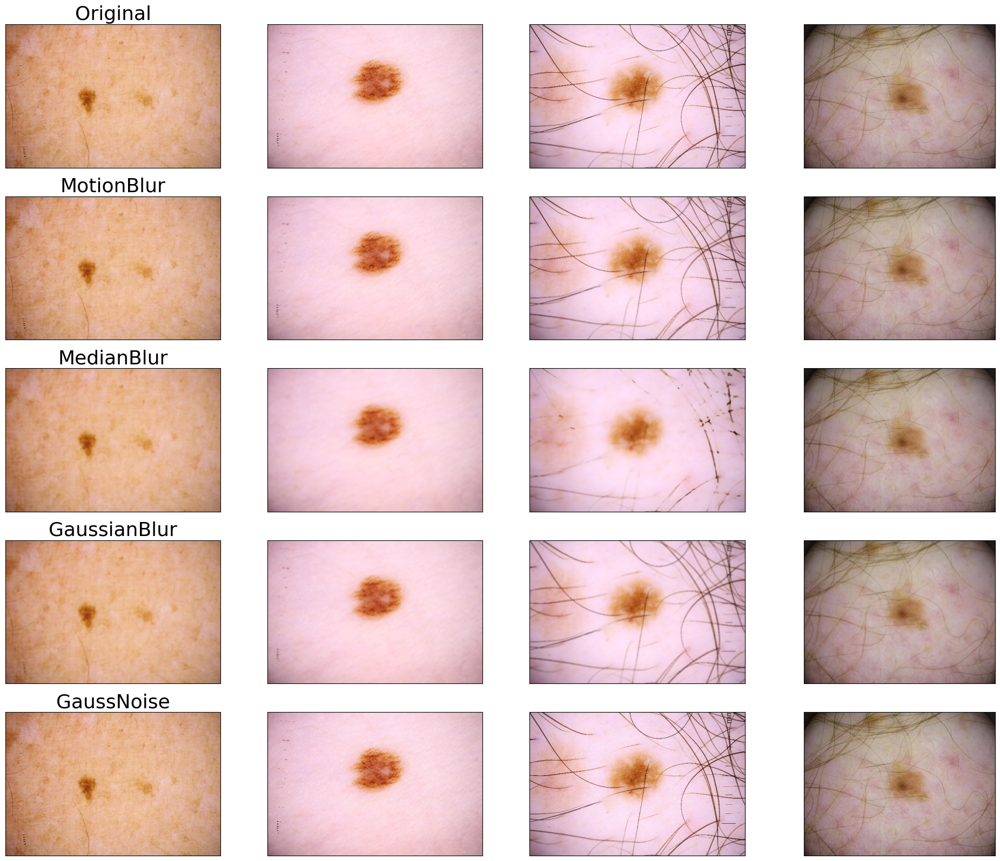

In [13]:
# Blur / Noise

transform1 = albumentations.MotionBlur(blur_limit=7,
                                       p=1)
transform2 = albumentations.MedianBlur(blur_limit=7,
                                       p=1)
transform3 = albumentations.GaussianBlur(blur_limit=(3,7),
                                         p=1)
transform4 = albumentations.GaussNoise(var_limit=(10.0, 50.0),
                                         p=1)

transformed1 = [transform1(image=image) for image in images]
transformed2 = [transform2(image=image) for image in images]
transformed3 = [transform3(image=image) for image in images]
transformed4 = [transform4(image=image) for image in images]

transformed_images1 = [t['image'] for t in transformed1]
transformed_images2 = [t['image'] for t in transformed2]
transformed_images3 = [t['image'] for t in transformed3]
transformed_images4 = [t['image'] for t in transformed4]

plot_images([images, transformed_images1, transformed_images2, transformed_images3, transformed_images4],
            titles=['Original', 'MotionBlur', 'MedianBlur', 'GaussianBlur', 'GaussNoise'])

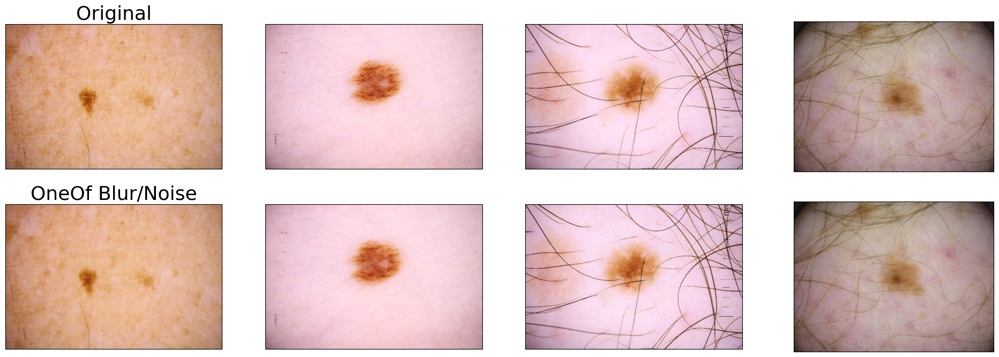

In [14]:
# Apply only one random Blur/Noise to each Image
transform = albumentations.OneOf([
    albumentations.MotionBlur(blur_limit=15),
    albumentations.MedianBlur(blur_limit=15),
    albumentations.GaussianBlur(blur_limit=(3,7)),
    albumentations.GaussNoise(var_limit=(20, 80))], 
    p=1)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'OneOf Blur/Noise'])

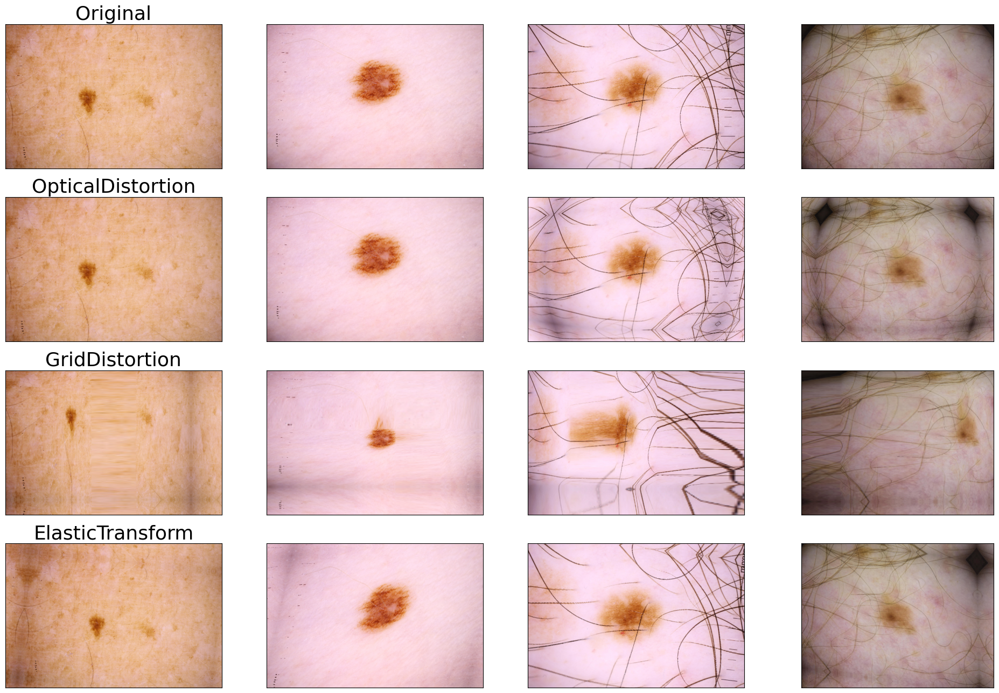

In [15]:
# Distortions

transform1 = albumentations.OpticalDistortion(distort_limit=1.0,
                                              p=1)
transform2 = albumentations.GridDistortion(num_steps=5, 
                                           distort_limit=1,
                                           p=1)
transform3 = albumentations.ElasticTransform(alpha=3,
                                             p=1)

transformed1 = [transform1(image=image) for image in images]
transformed2 = [transform2(image=image) for image in images]
transformed3 = [transform3(image=image) for image in images]

transformed_images1 = [t['image'] for t in transformed1]
transformed_images2 = [t['image'] for t in transformed2]
transformed_images3 = [t['image'] for t in transformed3]

plot_images([images, transformed_images1, transformed_images2, transformed_images3],
            titles=['Original', 'OpticalDistortion', 'GridDistortion', 'ElasticTransform'])

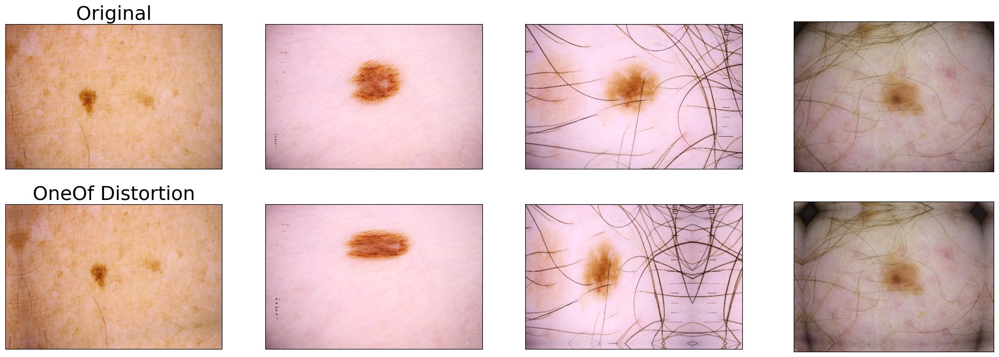

In [16]:
# Apply only one distortion to each Image
transform = albumentations.OneOf([
    albumentations.OpticalDistortion(distort_limit=0.5),
    albumentations.GridDistortion(num_steps=5,
                                  distort_limit=0.5),
    albumentations.ElasticTransform(alpha=1.5)],
    p=1)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'OneOf Distortion'])

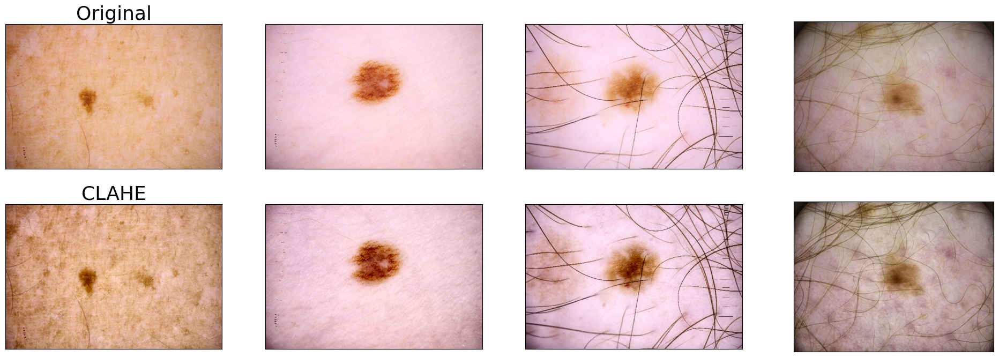

In [17]:
# CLAHE - Apply Contrast Limited Adaptive Histogram Equalization
transform = albumentations.CLAHE(clip_limit=2.0,
                                 p=1)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'CLAHE'])

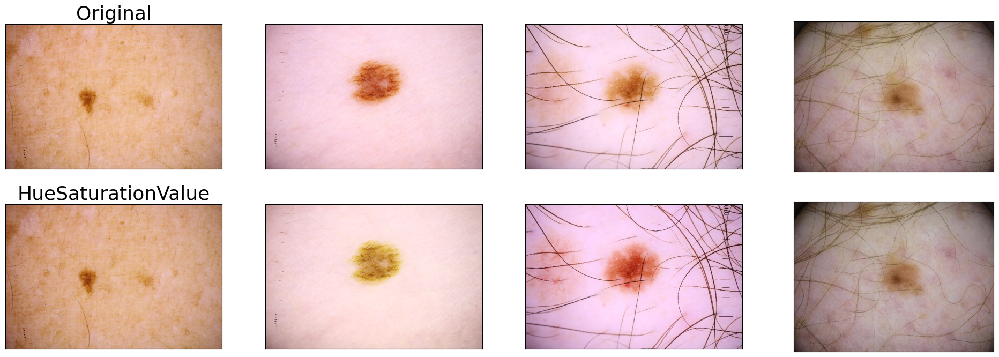

In [18]:
# HueSaturationValue - Randomly change hue, saturation and value
transform = albumentations.HueSaturationValue (hue_shift_limit=10, 
                                               sat_shift_limit=20, 
                                               val_shift_limit=8,
                                               p=1)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'HueSaturationValue'])

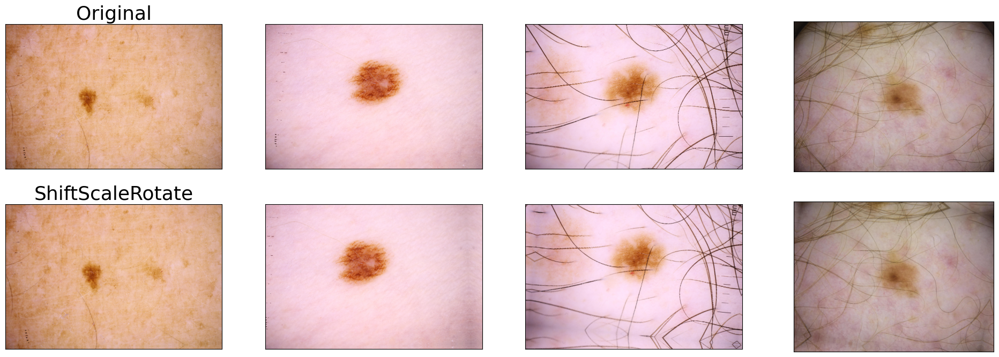

In [19]:
# ShiftScaleRotate - Randomly apply affine transforms: translate, scale and rotate
transform = albumentations.ShiftScaleRotate (shift_limit=0.1, 
                                             scale_limit=0.1, 
                                             rotate_limit=15, 
                                             border_mode=cv2.BORDER_REFLECT_101,  # default: cv2.BORDER_REFLECT_101
                                             p=1)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'ShiftScaleRotate'])

Width:  600
Height:  200


/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/dropout/cutout.py:49: FutureWarning: Cutout has been deprecated. Please use CoarseDropout
  warnings.warn(


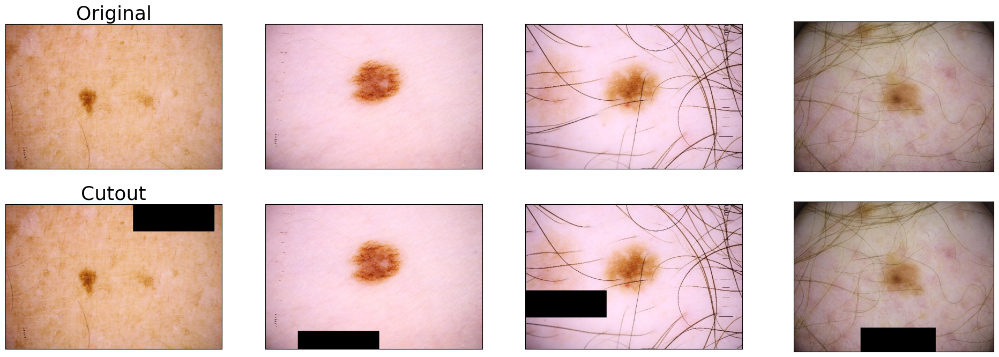

In [20]:
# Cutout - CoarseDropout of the square regions in the image.
print('Width: ', width)
print('Height: ', height)
transform = albumentations.Cutout(max_h_size=int(height * 0.375), 
                                  max_w_size=int(width * 0.375), 
                                  num_holes=1,
                                  p=1)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]

plot_images([images, transformed_images],
            titles=['Original', 'Cutout'])

[((400, 600, 3), dtype('uint8'), 0, 255), ((400, 600, 3), dtype('uint8'), 0, 255), ((400, 600, 3), dtype('uint8'), 0, 255), ((450, 600, 3), dtype('uint8'), 4, 243)]
[((400, 600, 3), dtype('float32'), 0.0, 1.0), ((400, 600, 3), dtype('float32'), 0.0, 1.0), ((400, 600, 3), dtype('float32'), 0.0, 1.0), ((450, 600, 3), dtype('float32'), 0.015686275, 0.95294124)]


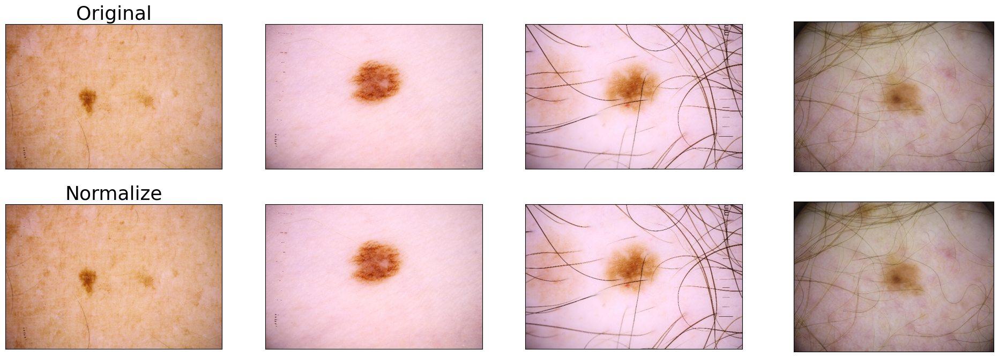

In [21]:
# Normalize - formula: img = (img - mean * max_pixel_value) / (std * max_pixel_value)
print([(i.shape, i.dtype, i.min(), i.max()) for i in images])
transform = albumentations.Normalize(p=1, mean=0.0, std=1.0)
transformed = [transform(image=image) for image in images]
transformed_images = [t['image'] for t in transformed]  # from uint8 0..255 to float32 0.0..1.0
print([(i.shape, i.dtype, i.min(), i.max()) for i in transformed_images])

plot_images([images, transformed_images],
            titles=['Original', 'Normalize'])

# Compose transforms

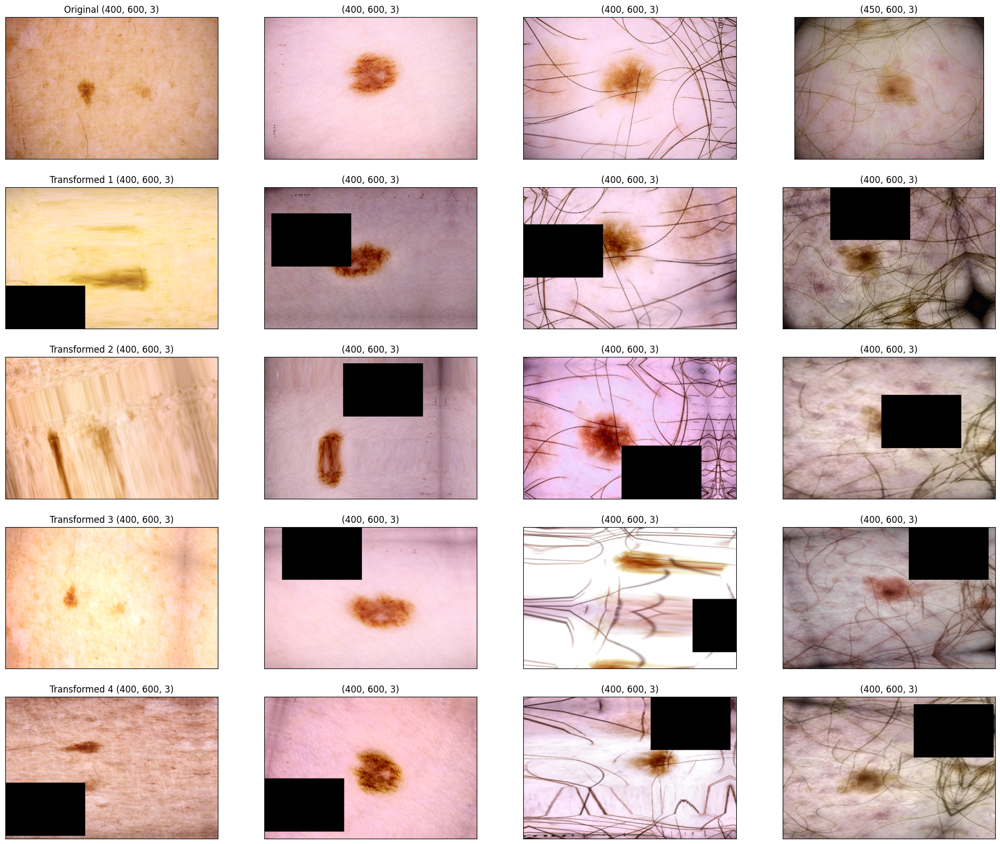

In [22]:
height = 400
width = 600

# Train Example:
transform_train = albumentations.Compose([
    albumentations.Transpose(p=0.5),
    albumentations.VerticalFlip(p=0.5),
    albumentations.HorizontalFlip(p=0.5),
    albumentations.RandomBrightnessContrast (brightness_limit=0.2, 
                                             contrast_limit=0.2,
                                             p=0.75),
    albumentations.OneOf([
        albumentations.MotionBlur(blur_limit=5),
        albumentations.MedianBlur(blur_limit=5),
        albumentations.GaussianBlur(blur_limit=(3,7)),
        albumentations.GaussNoise(var_limit=(7.0, 40.0)),
    ], p=0.7),

    albumentations.OneOf([
        albumentations.OpticalDistortion(distort_limit=1.0),
        albumentations.GridDistortion(num_steps=5, distort_limit=1.),
        albumentations.ElasticTransform(alpha=3),
    ], p=0.7),

    albumentations.CLAHE(clip_limit=3.0, p=0.7),
    albumentations.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=20, val_shift_limit=8, p=0.5),
    albumentations.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=15, border_mode=cv2.BORDER_REFLECT_101, p=0.85),
    albumentations.Resize(height=height,
                          width=width,),
    albumentations.Cutout(max_h_size=int(height * 0.375), max_w_size=int(width * 0.375), num_holes=1, p=0.7),
    albumentations.Normalize(mean=0.0, std=1.0)
])

transformed_images1 = [transform_train(image=image)['image'] for image in images]
transformed_images2 = [transform_train(image=image)['image'] for image in images]
transformed_images3 = [transform_train(image=image)['image'] for image in images]
transformed_images4 = [transform_train(image=image)['image'] for image in images]

plot_images([images, transformed_images1, transformed_images2, transformed_images3, transformed_images4],
            titles=['Original', 'Transformed 1', 'Transformed 2', 'Transformed 3', 'Transformed 4'],
            display_shape=True)

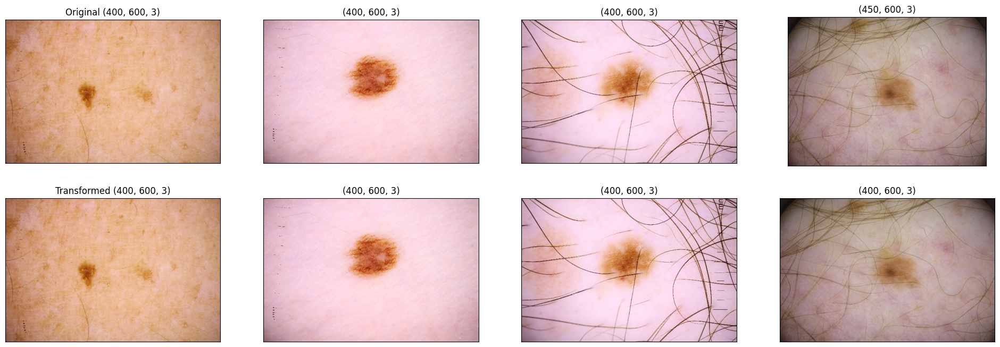

In [23]:
# Corresponding Validation:
transform_val = albumentations.Compose([
    albumentations.Resize(height=height,
                          width=width,),
    albumentations.Normalize(mean=0.0, std=1.0)
])

transformed_images = [transform_val(image=image)['image'] for image in images]

plot_images([images, transformed_images],
            titles=['Original', 'Transformed'],
            display_shape=True)